# Midterm Project

Submission by Jeff v. Stritzky (3207189)

## 1. Data and Preprocessing (5 pts)

### 1.1 Libraries

**Note:** Besides the libraries used in the practice sessions, **sklearn and plotly** are used. Plotly is exclusively used for simple and interactive plotting of three-dimensional relationships and the visualization of regional differences. As the visualization results of plotly are not reliably stored in output cells, I included them as png files in the assignment folder.

In [17]:
# general 
import pandas as pd
import numpy as np
from collections import defaultdict
from collections import Counter
import time 
import multiprocessing

# visualization
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import plotly.express as px
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.filterwarnings('ignore')

# nlp
import re
import spacy
from spacy.language import Language
from spacy_langdetect import LanguageDetector
nlp = spacy.load('en_core_web_sm')
import nltk
from nltk import SnowballStemmer
from nltk.collocations import BigramCollocationFinder, BigramAssocMeasures
from gensim.models import Word2Vec
from gensim.models import Doc2Vec
from gensim.models.doc2vec import TaggedDocument
from gensim.models.word2vec import FAST_VERSION
from gensim.models import LdaMulticore, TfidfModel, CoherenceModel
from gensim.corpora import Dictionary
from gensim.models.phrases import Phrases
from gensim.models import AuthorTopicModel
from gensim.test.utils import datapath, temporary_file

# sklearn
from sklearn.manifold import TSNE
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.decomposition import NMF
from sklearn.decomposition import TruncatedSVD
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler

Set visualization parameters

In [3]:
N_col = 256

# set democratic color map 
vals_dem = np.ones((N_col, 4))
vals_dem[:, 0] = np.linspace(40/256, 0.7, N_col)
vals_dem[:, 1] = np.linspace(40/256, 0.8, N_col)
vals_dem[:, 2] = np.linspace(256/256, 1, N_col)
cmp_dem = ListedColormap(vals_dem)

# set republican color map 
vals_rep = np.ones((N_col, 4))
vals_rep[:, 0] = np.linspace(256/256, 1, N_col)
vals_rep[:, 1] = np.linspace(50/256, 0.8, N_col)
vals_rep[:, 2] = np.linspace(0/256, 1, N_col)
cmp_rep = ListedColormap(vals_rep)

party_palette = ["#0000ff", "#ff0803"]

sns.set_theme('notebook', font_scale=1.1)

### 1.2 Dataset

For the analysis, I extracted the last 1000 tweets for each of the current 100 US senators via the Tweepy API. Retweets were excluded. Afterward, the tweets were enriched with data on the senator's party, state, gender, and other meta information found in two GitHub datasets. Notably, the two independent us senators (Bernie Sanders and Angus King) were classified as democratic for reasons of simplicity and their long-lasting affiliation with the democratic party. 

The exact extraction and merging steps to get the dataset can be found in the enclosed notebook “get_dataset.ipynb.” The script was last executed on Friday, 25.03.22.

In [4]:
# read raw data and create copy 
df_raw = pd.read_csv('tweets_raw.csv')

df = df_raw

In [5]:
# brief overview of dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99076 entries, 0 to 99075
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   created_at      99076 non-null  object
 1   text            99076 non-null  object
 2   twitter_handle  99076 non-null  object
 3   state_name      99076 non-null  object
 4   state_code      99076 non-null  object
 5   region          99076 non-null  object
 6   party           99076 non-null  object
 7   democrat        99076 non-null  int64 
 8   gender          99076 non-null  object
 9   male            99076 non-null  int64 
 10  ethnicity       99076 non-null  object
 11  religion        99076 non-null  object
 12  openly_lgbtq    99076 non-null  object
 13  date_of_birth   99076 non-null  object
 14  entered_office  99076 non-null  object
dtypes: int64(2), object(13)
memory usage: 11.3+ MB


### 1.3 Cleaning

To clean the raw tweets, several steps were taken. First, all tweets before 2021 were filtered out. As the tweet volume per senator varies, tweets for senators who tweet comparably little can go far back in time and therefore create noise in the data with different topics. Secondly, tweets were converted to lower case, and links, emojis, and punctuation were removed. Thirdly, as one goal of the analysis is to capture nuanced differences in party reaction to current topics, I looked at common collocations and abbreviations to standardize common terms and topics. This included, for instance, standardizing the description of covid-19 and replacing the commonly used abbreviation “POTUS” with Donald Trump and Joe Biden under consideration of their terms of office. Lastly, to clean the data more aggressively for certain analyses (especially topic models), lemmatization was conducted and only content words were considered.

Generally, two cleaned columns were kept: 
- **text_clean**: links, emojis, and punctuation removed, and most common collocations and terms merged
- **tweet_clean_aggressive**: all the previous steps plus lemmatization, stop word removal, and only considering content words with length > 2

This was done to try out analyses with different degrees of cleaning and check for optimal performance. 

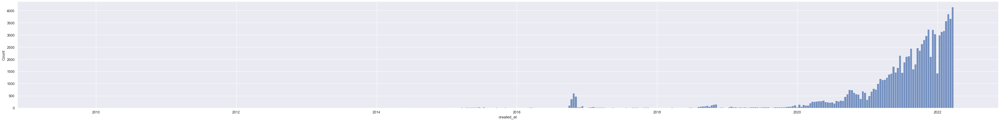

In [6]:
# check distribution of tweets to decide on cut-off date
df['created_at'] = pd.to_datetime(df['created_at'])
sns.displot(df, x="created_at", aspect = 8, height = 6)

In [7]:
# only consider tweets starting from 2020 
df = df[df["created_at"] >= '2021-01-01']

In [8]:
# convert everything to lower-case
df['text_clean'] = df['text'].str.lower()

In [9]:
# use regular expressions to remove links 
df['text_clean'] = df['text_clean'].apply(lambda x: re.split('https:\/\/.*', str(x))[0])

In [10]:
# remove emojis 
filter_char = lambda c: ord(c) < 256
df['text_clean'] = df['text_clean'].apply(lambda s: ''.join(filter(filter_char, s)))

In [11]:
# check for common collocations
documents = df.text_clean.tolist()

from nltk.corpus import stopwords

stopwords_ = set(stopwords.words('english'))

words = [word.lower() for document in documents for word in document.split() 
         if len(word) > 2 
         and word not in stopwords_]

finder = BigramCollocationFinder.from_words(words)
bgm = BigramAssocMeasures()
score = bgm.mi_like

collocations = {'_'.join(bigram): pmi 
                for bigram, pmi in finder.score_ngrams(score)}
Counter(collocations).most_common(300)

[('look_forward', 358.03609450163543),
 ('supreme_court', 261.1354380361003),
 ('bipartisan_infrastructure', 256.76431944761515),
 ('united_states', 253.37573372803456),
 ('voting_rights', 223.71582560623193),
 ('loved_ones', 199.31695156695156),
 ('health_care', 175.8573123227824),
 ('supply_chain', 163.344670846395),
 ('ketanji_brown', 152.2484898045319),
 ('john_lewis', 151.9112308073883),
 ('nord_stream', 149.53263443655058),
 ('biden_administration', 147.29740767000334),
 ('tune_in!', 129.11239930738537),
 ('president_biden', 129.10184761260274),
 ('make_sure', 124.54063678778657),
 ('small_businesses', 107.26391849567112),
 ('martin_luther', 102.38461538461539),
 ('law_enforcement', 98.98377658479478),
 ('build_back', 87.24492509692668),
 ('rescue_plan', 85.49401858304297),
 ('sen._@ossoff', 85.19645999352777),
 ('american_rescue', 84.91951347405244),
 ('roe_wade', 66.0111391694725),
 ('god_bless', 64.91731330830204),
 ('men_women', 61.5973542714693),
 ('illegal_immigrants', 60.5

In [12]:
# merge common collocation and standardize potentially relevant topics
collocations_replacement_dict = {'supreme court':'supremecourt',
 'health care': 'healthcare',
 'rescue plan': 'rescueplan',
 'supply chain': 'supplychain',
 'small businesses': 'smallbusinesses', 
 'climate change': 'climatechange', 
 'climate crisis': 'climatechange',
 'global warming': 'climatechange', 
 'fossil fuels': 'fossilfuels',
 'nord stream': 'nordstream',
 'nordstream2': 'norstream', 
 'law enforcement': 'lawenforecement',
 'mental health': 'mentalhealth',
 'child care': 'childcare',
 'white house': 'whitehouse',
 'national security': 'nationalsecurity',
 'tax credit': 'taxcredit',
 'voter suppression': 'votersuppression',
 'gun violence': 'gunviolence',
 'gun control': 'guncontrol',                             
 'minimum wage': 'minimumwage',
 'vaccine mandate': 'vaccinemandate',
 'student loan': 'studentloan',
 'infrastructure bill': 'infrastructurebill',
 'infrastructure-bill': 'infrastructurebill',
 'prescription drugs': 'prescriptiondrugs',
 'debt ceiling': 'debtceiling',
 'supply chains': 'supplychain',
 'middle class': 'middleclass',
 'delta variant': 'deltavariant',
 'vaccine mandates': 'vaccinemandate',
 'vaccinemandates': 'vaccinemandate',
 'sen.': 'senator',
 'covid19':'covid',
 'covid-19':'covid',
 'coronavirus': 'covid',
 'corona virus': 'covid',
 'sarscov2': 'covid', 
 'joebiden': 'joe biden',
 '@joebiden': 'joe biden',
 'bidens': 'biden', 
 'putins': 'putin',
 'donaldtrump':'donald trump',
 '@donaldtrump':'donald trump',
 "potus's": "potus",
 'affordable care act':'affordablecareact', 
 'gender wage gap': 'genderwagegap',
 'student debt': 'studentdebt',
 '&amp': 'and', 
 'build back better':'buildbackbetter',
 'january 6th': 'january6th'
}

df["text_clean"].replace(collocations_replacement_dict, inplace=True, regex = True)

In [13]:
# remove punctuation
df['text_clean'] = df['text_clean'].str.replace('[^\w\s]','')

In [14]:
# replace POTUS with Donald Trump or Joe Biden for their respective terms 
df[df["created_at"] < "2021-01-20 18:00:00+00:00"]["text_clean"] = df[df["created_at"] < "2021-01-20 18:00:00+00:00"]["text_clean"].str.replace('potus','donald trump')
df[df["created_at"] >= "2021-01-20 18:00:00+00:00"]["text_clean"] = df[df["created_at"] >= "2021-01-20 18:00:00+00:00"]["text_clean"].str.replace('potus','joe biden')

In [15]:
# drop tweets that are empty after the preceeding cleaning steps
df['text_clean'].replace('', np.nan, inplace=True)
df.dropna(subset=['text_clean'], inplace=True)

In [19]:
# detect and filter out Spanish tweets
def get_lang_detector(nlp, name):
    return LanguageDetector()

Language.factory("language_detector", func=get_lang_detector) # to set up language detection
nlp.add_pipe('language_detector', last=True) # to set up language detection

def detect_spanish_tweets(text):
    doc = nlp(text)
    if doc._.language["language"] == "es":
        return 1 

df['es_label'] = df.text_clean.apply(detect_spanish_tweets)
df = df[df['es_label'] != 1]
df.drop("es_label", axis = 1, inplace = True)

In [20]:
# lemmatize, only consider content words, remove stop words and words with length <=2
nlp = spacy.load('en_core_web_sm')

def clean(text):
    return ' '.join([token.lemma_ # keep the base form
                     for token in nlp(text) # after splitting the sentence into words
                     if token.pos_ in {'NOUN', 'ADJ', 'ADV', 'PROPN', 'VERB'} # only consider content words
                     and len(token) > 2 # only consider words > 2 characters
                     and not token.is_stop]) # remove stop words 

df['tweet_clean_aggressive'] = df.text_clean.apply(clean)

In [21]:
# drop tweets again that are empty after the preceeding cleaning steps
df['tweet_clean_aggressive'].replace('', np.nan, inplace=True)
df.dropna(subset=['tweet_clean_aggressive'], inplace=True)

In [22]:
# add token counts  
def length(text):
    return len(text)

df["text_len"] = df.text.apply(length)
df["text_clean_len"] = df.text_clean.apply(length)
df["tweet_clean_aggressive_len"] = df.tweet_clean_aggressive.apply(length)

In [23]:
# export for potentially faster import without cleaning
df.to_csv("data_cleaned.csv", index = False)

In [25]:
# create subsets for party specific analysis
df_dem = df[df["democrat"] == 1]
df_rep = df[df["democrat"] == 0]

### 1.4 Document and Token Comparison

#### Document Comparison

In [26]:
# put total token counts into dataframe for visualization
document_counts_total = [("raw", df_raw.shape[0]) , 
("cleaned", df.shape[0])]
df_barplot_doc_total = pd.DataFrame(data = document_counts_total, columns = ["type", "count"])

In [27]:
# put token counts for two parties into dataframe for visualization
document_counts = [("dem.", "raw", df_raw[df_raw["democrat"] == 1].shape[0]),
                ("dem.", "cleaned", df_dem.shape[0]),
                ("rep.", "raw", df_raw[df_raw["democrat"] == 0].shape[0]),
                ("rep.", "cleaned", df_rep.shape[0])]

df_doc_barplot = pd.DataFrame(data = document_counts, columns = ["party", "type", "count"])

[(0.0, 120000.0)]

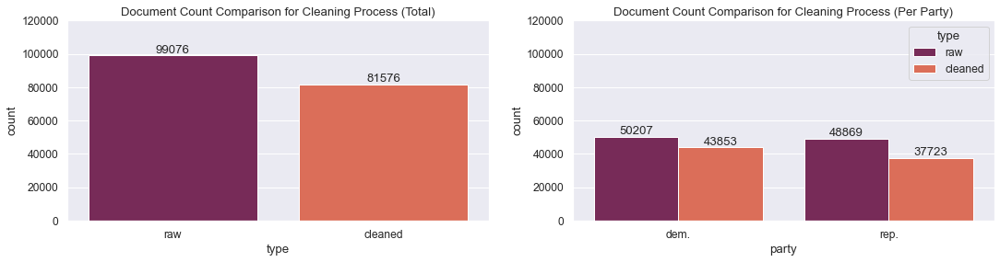

In [28]:
# plot token counts
fig, (ax1, ax2) = plt.subplots(nrows = 1,ncols=2, figsize=(18, 4))

ax1.title.set_text("Document Count Comparison for Cleaning Process (Total)")
sns.barplot(data = df_barplot_doc_total, x = "type", y = "count", palette = "rocket", ax = ax1)
ax1.bar_label(ax1.containers[0])
ax1.set(ylim=(0, 120000))

ax2.title.set_text("Document Count Comparison for Cleaning Process (Per Party)")
sns.barplot(data = df_doc_barplot, x = "party", y = "count", hue = "type", palette ="rocket", ax = ax2)
for container in ax2.containers:
    ax2.bar_label(container)
ax2.set(ylim=(0, 120000))

Overall, approximately 82000 tweets are analysed. There are slightly more democratic tweets than republican tweets in the datasete.

#### Token Comparison

In [29]:
# put total token counts into dataframe for visualization
token_counts_total = [("raw", df["text_len"].sum()), 
("clean", df["text_clean_len"].sum()), 
("clean_aggressive", df["tweet_clean_aggressive_len"].sum())]
df_barplot_total = pd.DataFrame(data = token_counts_total, columns = ["type", "count"])
df_barplot_total["count (m)"] = round((df_barplot_total["count"] / 1000000),2)

In [30]:
# put token counts for two parties into dataframe for visualization
token_counts = [("dem.", "raw", df_dem.groupby("party").sum()["text_len"][0]), 
("dem.", "clean", df_dem.groupby("party").sum()["text_clean_len"][0]), 
("dem.", "clean_aggressive", df_dem.groupby("party").sum()["tweet_clean_aggressive_len"][0]), 
("rep.", "raw", df_rep.groupby("party").sum()["text_len"][0]), 
("rep.", "clean", df_rep.groupby("party").sum()["text_clean_len"][0]), 
("rep.", "clean_aggressive", df_dem.groupby("party").sum()["tweet_clean_aggressive_len"][0])]

df_barplot = pd.DataFrame(data = token_counts, columns = ["party", "type", "count"])
df_barplot["count (m)"] = round((df_barplot["count"] / 1000000),2)

[(0.0, 20.0)]

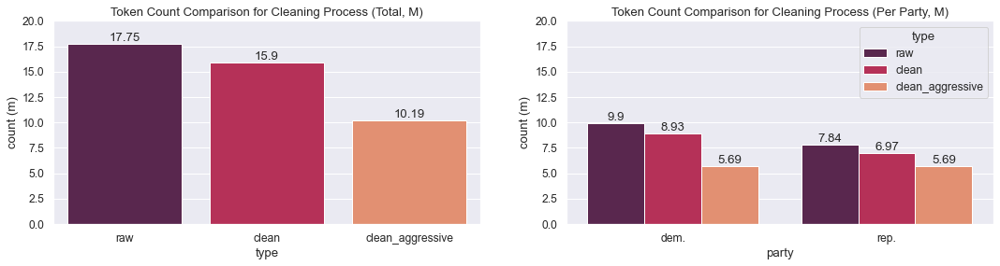

In [31]:
# plot token counts
fig, (ax1, ax2) = plt.subplots(nrows = 1,ncols=2, figsize=(18, 4))

ax1.title.set_text("Token Count Comparison for Cleaning Process (Total, M)")
sns.barplot(data = df_barplot_total, x = "type", y = "count (m)", palette = "rocket", ax = ax1)
ax1.bar_label(ax1.containers[0])
ax1.set(ylim=(0, 20))

ax2.title.set_text("Token Count Comparison for Cleaning Process (Per Party, M)")
sns.barplot(data = df_barplot, x = "party", y = "count (m)", hue = "type", palette ="rocket", ax = ax2)
for container in ax2.containers:
    ax2.bar_label(container)
ax2.set(ylim=(0, 20))

## 2. Analysis (15 pts)


The overall goal of the analysis is to capture political differences between the democratic and republican parties in the united states. This includes, different political ideologies, different reactions to current events and regional differences. Particularly, I am interested if commonly known dissimilarities can be re-discovered only through tweets. 

### 2.1 Word Embeddings

Word embeddins are deployed on the lemmatized tweets to discover party differences in associated words for politically controversial keywords.

In [311]:
# create function to generate w2v model
def generate_w2v(df): 
    
    documents = df.tweet_clean_aggressive.tolist()

    corpus = [document.split() for document in documents]

    # initialize model
    w2v_model = Word2Vec(vector_size=300, # vector size large due to large corpus
                         window= 80, # window for sampling relatively large to capture semantic similarity 
                         sample=0.0001, # subsampling rate
                         epochs=600, # iterations
                         negative=15, # negative samples
                         min_count=60, # minimum threshold, relatively high due to large corpus 
                         workers=-1, # parallelize to all cores
                         hs=0, # no hierarchical softmax
    )

    # build the vocabulary
    w2v_model.build_vocab(corpus)

    # train the model
    w2v_model.train(corpus, 
                    total_examples=w2v_model.corpus_count, 
                    epochs=w2v_model.epochs)
    
    return w2v_model

In [33]:
# fit model on subsets for each party
w2v_dem = generate_w2v(df_dem)
w2v_rep = generate_w2v(df_rep)

Can now check for differences in similar words for controversial political topics to get a rough idea about differences between parties

In [314]:
w2v_dem.wv.most_similar("climatechange")

[('responsibility', 0.1840178519487381),
 ('outstanding', 0.17439760267734528),
 ('independence', 0.17198778688907623),
 ('storm', 0.16821610927581787),
 ('man', 0.16026096045970917),
 ('western', 0.15980052947998047),
 ('strong', 0.1578347533941269),
 ('grid', 0.15503795444965363),
 ('greed', 0.15458805859088898),
 ('majority', 0.1504828780889511)]

In [304]:
w2v_rep.wv.most_similar(["climatechange"])

[('effective', 0.19015245139598846),
 ('beginning', 0.15296348929405212),
 ('mind', 0.14840185642242432),
 ('propaganda', 0.14645825326442719),
 ('louisiana', 0.14281673729419708),
 ('tomorrow', 0.14277954399585724),
 ('wrong', 0.1420334428548813),
 ('slow', 0.14074859023094177),
 ('air', 0.13985885679721832),
 ('faith', 0.13391506671905518)]

### 2.1.1 Word Embeddings (Visualization)

Dimensionality reduction through T-distributed Stochastic Neighbor Embedding is used to visualize similar terms and preserve local similarity.

In [319]:
def plot_similarwords(term, n, model, colormap, perplexity, party): 
    
    similar_terms = model.most_similar(term, topn = n)
    similar_docs_df = pd.DataFrame(data = similar_terms, columns = ["term", "similarity"])
    similar_docs_df["similarity"] = similar_docs_df["similarity"].round(2) 
    
    # reduce dimensionality of target handle and similar accounts   
    X_tsne_doc = TSNE(n_components=2, random_state=32, perplexity = perplexity, n_iter = 2000 ).fit_transform(model.vectors)
    select_df = pd.DataFrame({"term":model.index_to_key, "x":X_tsne_doc[:,0], "y":X_tsne_doc[:,1]})
    select_df = select_df[select_df["term"].isin(list(similar_docs_df["term"].unique()))]
    select_df.reset_index(drop=True, inplace = True)
    
    # merge with similarity df 
    select_df = pd.merge(select_df, similar_docs_df,  on="term", how="outer")
    
    # create scatter plot
    plt.figure(figsize=(15,7))
    p1 = sns.scatterplot(data = select_df, x = "x", y = "y", palette=colormap, hue = select_df["similarity"], size = select_df["similarity"], sizes=(200, 2000) )
    for line in range(0,select_df.shape[0]):
         p1.text(select_df.x[line], select_df.y[line]+0.05, 
         select_df.term[line], horizontalalignment='center', va = "top", 
         size='small', color='black',)
            
    p1.set(title = f"Top {n} Most Similar Words for '{term.capitalize()}' Based on Word2Vec for {party}")
    
    h,l = p1.get_legend_handles_labels()
    plt.legend(h[0:3],l[0:3], title="Similarity")
    plt.show(p1)

Can now plot most similar n terms for certain keywords. Perplexity was set relatively high to get a sense of potential clusters.

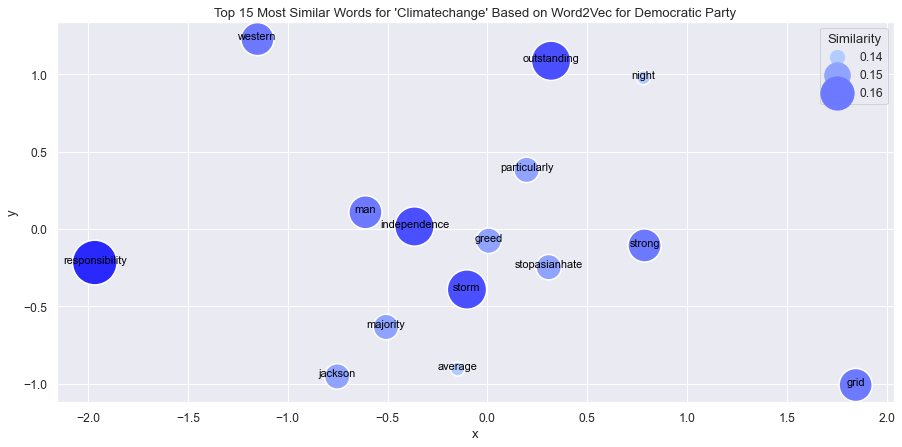

In [320]:
plot_similarwords(term = "climatechange", n = 15, model = w2v_dem.wv, colormap = cmp_dem.reversed(), perplexity = 100, 
                  party = "Democratic Party")

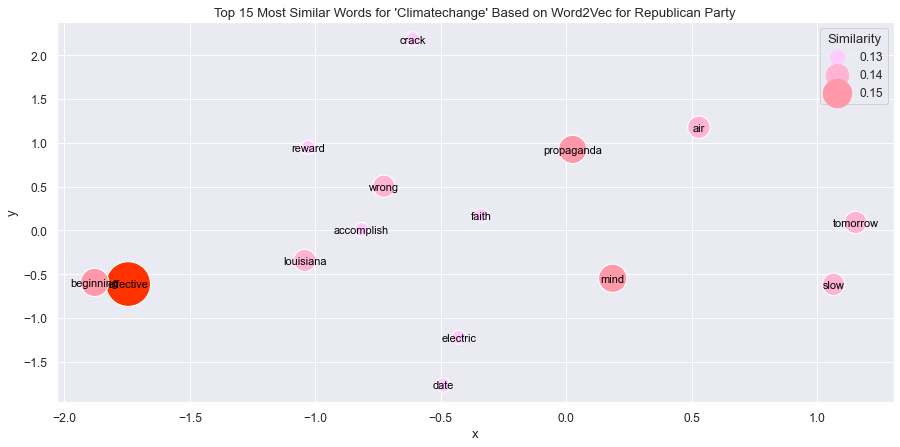

In [321]:
plot_similarwords(term = "climatechange", n = 15, model = w2v_rep.wv, colormap = cmp_rep.reversed(), perplexity = 100, 
                  party = "Republican Party")

While not being an extremely meaningful for analyses, looking at the most similar words already reveals some insights into differences in political attitudes between both parties. 

### 2.2 Document Embeddings

Document Embeddings are used to discover similarities between senators' tweets. Therefore, all tweets of one senator are treated as one document. For the model, only the semi-cleaned tweets are used to not lose too much information on semantic and syntactic differences between the senators.

In [100]:
# create a list of TaggedDocument objects
corpus = []

for row in df.iterrows():
    label = row[1].twitter_handle
    text = row[1].text_clean
    corpus.append(TaggedDocument(words=text.split(), 
                                 tags=[str(label)]))

In [101]:
# initialize model
d2v_model = Doc2Vec(vector_size=400, # relatively large, due to large corpus
                    window=120, # high due to large corpus and to capture semantic similarity
                    hs=0, 
                    sample=0.00001,
                    negative=20,
                    min_count=50, # high due to corpus size but not too high to capture different topics for senators
                    workers=-1, 
                    epochs=600,
                    dm=0, 
                    dbow_words=1)

# build the vocabulary
d2v_model.build_vocab(corpus)

# train the model
d2v_model.train(corpus, total_examples=d2v_model.corpus_count, epochs=d2v_model.epochs)

Can now check for similar tweet profiles between senators:

In [103]:
print(d2v_model.dv.most_similar("SenSanders", topn = 5))

[('SenMarkey', 0.12501345574855804), ('jiminhofe', 0.10957000404596329), ('robportman', 0.09782887995243073), ('kyrstensinema', 0.0875222310423851), ('SenJohnThune', 0.07935107499361038)]


### 2.2.1 Document Embeddings (Visualization)

Similarly to word embeddings, a function is created to plot a chosen number of similar Twitter accounts for a given input account. Again, TSNE is used for dimensionality reduction to preserve local similarities and color coding is added to see if similar Twitter accounts are actually from the same party.

In [317]:
def plot_similardocs(target_handle, n): 
    
    # get similarity values for target handle 
    similar_docs = d2v_model.dv.most_similar(target_handle, topn = n)
    similar_docs_df = pd.DataFrame(data = similar_docs, columns = ["twitter_handle", "similarity"])
    similar_docs_df["similarity"] = similar_docs_df["similarity"].round(2) 
    
    # reduce dimensionality of target handle and similar accounts   
    X_tsne_doc = PCA(2).fit_transform(d2v_model.dv.vectors)
    doc2vec_df = pd.DataFrame({"twitter_handle":d2v_model.dv.index_to_key, "x":X_tsne_doc[:,0], "y":X_tsne_doc[:,1]})
    doc2vec_df_merged = pd.merge(df[["twitter_handle","party", "gender"]],doc2vec_df, on="twitter_handle", how="outer")
    doc2vec_df_merged.drop_duplicates(inplace=True)
    doc2vec_df_merged.reset_index(inplace=True, drop = True)
    select_df = doc2vec_df_merged[doc2vec_df_merged["twitter_handle"].isin(list(similar_docs_df["twitter_handle"].unique()))]
    select_df.reset_index(drop=True, inplace = True)
    
    # merge with similarity df 
    select_df = pd.merge(select_df, similar_docs_df,  on="twitter_handle", how="outer")
    
    # create scatter plot
    plt.figure(figsize=(18,7))
    p1 = sns.scatterplot(data = select_df, x = "x", y = "y", hue = "party", palette = sns.color_palette(reversed(party_palette), 2, ), size = select_df["similarity"], sizes=(200, 2000), 
     hue_order = ["republican", "democrat"]               )
    for line in range(0,select_df.shape[0]):
         p1.text(select_df.x[line]+0.0004, select_df.y[line], 
         select_df.twitter_handle[line], horizontalalignment='left', 
         size='small', color='black')
            
    p1.set(title = f"Top {n} Most Similar Twitter Accounts for {target_handle} Based on Doc2Vec")
    
    h,l = p1.get_legend_handles_labels()
    plt.legend(h[0:3],l[0:3])
    plt.show(p1)

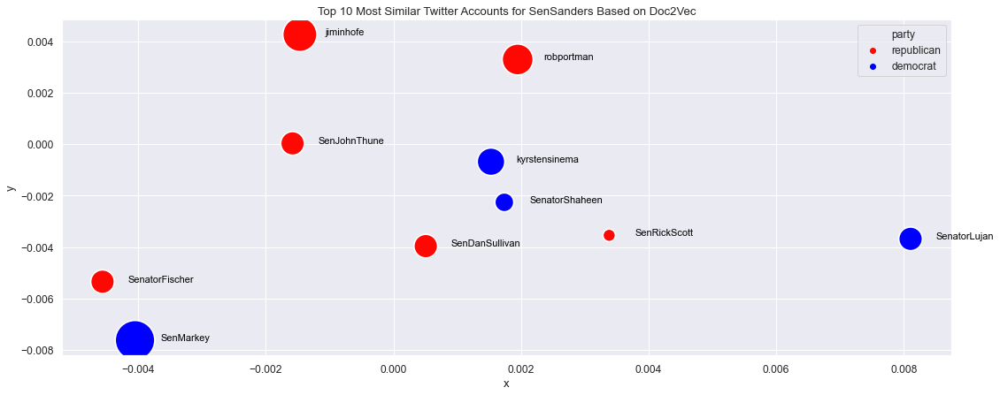

In [318]:
plot_similardocs("SenSanders", 10)

I initially assumed that doc2vec would primarily find accounts from the same party to be similar. However, after looking closer at the resulting senators and their associated ideology score (https://www.govtrack.us/congress/members/report-cards/2018/senate/ideology), it seems like the model generally considers more politically extreme accounts from both sides of the spectrum to be more similar. For instance, Senator Sanders has an ideology score of 0.01 and Senator Inhofe's score is 1 (0-1 range)

### 2.3 Topic models

Next, I deployed a topic model to discover significant topics within the tweets and show differences in topic domination between parties. Initially, I created a regular topic model. Results, however, did not show meaningful differences between parties or regions, which is why an author topic model is used.

For the topic model, the aggressively cleaned tweets are used, to avoid as much noise as possible. 

In [106]:
instances = df['tweet_clean_aggressive'].apply(str.split).tolist()

# read in instances and create Dictionary object w information about frequencies etc. 
phrases = Phrases(instances, min_count=5, threshold=1)
instances_colloc = phrases[instances]

dictionary = Dictionary(instances_colloc)

# get rid of words that are too rare or too frequent
dictionary.filter_extremes(no_below=100, no_above=0.1) # being relatively radical due to large corpus and potentially many topics 

In [107]:
#replace words by their numerical IDs and their frequency
ldacorpus = [dictionary.doc2bow(text) for text in instances]
# learn TFIDF values from corpus
tfidfmodel = TfidfModel(ldacorpus)
# transform raw frequencies into TFIDF
model_corpus = tfidfmodel[ldacorpus]

In [108]:
target_category = "party"

In [109]:
author2doc = defaultdict(list) # mapping from party to document
for i, target in enumerate(df[target_category]):
    author2doc[target].append(i)

In [355]:
coherence_values = []
author_model_list = []

dev_size = 15000

dev_author2doc = {key: [idx for idx in value if idx < dev_size] for key, value in author2doc.items()}

for num_topics in range(2, 15):
    author_model = AuthorTopicModel(corpus=list(ldacorpus[:dev_size]), 
                                    author2doc=dev_author2doc, # the only difference to LDA 
                                    id2word=dictionary, 
                                    num_topics=num_topics,
                                    alpha = 0.5,
                                    random_state=17
                                   )
    
    coherencemodel_umass = CoherenceModel(model=author_model, 
                                          texts=instances[:dev_size], 
                                          dictionary=dictionary, 
                                          coherence='u_mass')

    coherencemodel_cv = CoherenceModel(model=author_model, 
                                       texts=instances[:dev_size], 
                                       dictionary=dictionary, 
                                       coherence='c_v')

    umass_score = coherencemodel_umass.get_coherence()
    cv_score = coherencemodel_cv.get_coherence()
    
    print(num_topics, umass_score, cv_score)
    coherence_values.append((num_topics, umass_score, cv_score))

2 -2.6648168795541354 0.17701300545886833
3 -3.022528388249574 0.2288957453261724
4 -3.1953412533079097 0.26055696962849284
5 -3.095828533710723 0.29972601488676454
6 -3.5693060544611743 0.34560340279231966
7 -3.901617892441358 0.3320941168798597
8 -4.064030757116435 0.2981733158181489
9 -4.3986660680189145 0.31623805939487315
10 -4.432826571615342 0.32456309336979666
11 -4.560172871247753 0.30406573467392045
12 -4.868509282527436 0.3133742346934765
13 -4.958018663632606 0.2999969768296821
14 -5.0408228396433765 0.30223536891498787


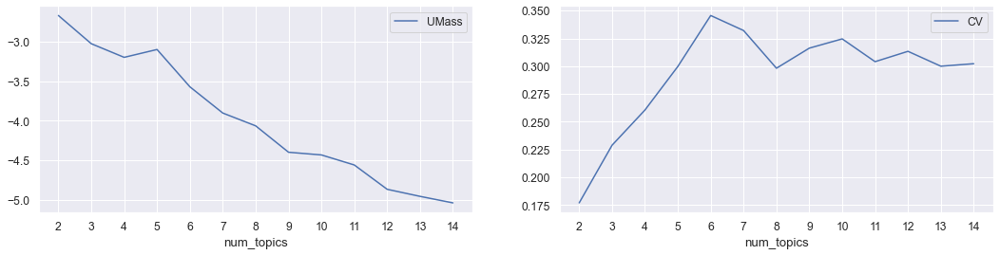

In [356]:
# plot results from test runs to decide on number of topics 
scores = pd.DataFrame(coherence_values, columns=['num_topics', 'UMass', 'CV'])
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(18, 4))
scores.plot.line(x='num_topics', y='UMass', ax=ax[0], xticks=range(2,15));
scores.plot.line(x='num_topics', y='CV', ax=ax[1], xticks=range(2,15));

Based on the values for CV and UMass, 5 topics are selected for the model.

In [362]:
# train model with best number of topics
n_topics_author = 5

# find chunksize to make about 200 updates
num_passes = 10
chunk_size = len(model_corpus) * num_passes/200

author_model = AuthorTopicModel(corpus=list(ldacorpus), 
                                author2doc=author2doc, 
                                id2word=dictionary, 
                                num_topics=n_topics_author,
                                passes=num_passes,
                                chunksize=chunk_size,
                                alpha=0.5,
                                random_state=17
)

In [363]:
# extract a list of tuples with topic number and descriptors from the model
topic_sep = re.compile("0\.[0-9]{3}\*") # getting rid of useless formatting

author_model_topics = [(topic_no, re.sub(topic_sep, '', model_topic).split(' + ')) for topic_no, model_topic in
                author_model.print_topics(num_topics=n_topics_author, num_words=5)]

author_descriptors = []
for i, m in sorted(author_model_topics):
    print(i+1, ", ".join(m[:5]))
    author_descriptors.append(", ".join(m[:2]).replace('"', ''))

1 "biden", "president", "people", "energy", "ukraine"
2 "biden", "border", "democrats", "american", "americans"
3 "work", "today", "help", "community", "support"
4 "right", "need", "family", "american", "work"
5 "money", "republican", "act", "protect", "include"


### 2.3.1 Topic Model (Visualization)

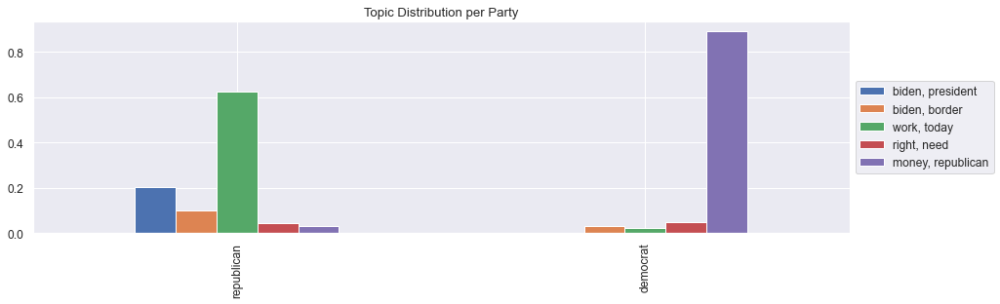

In [364]:
# initialize mapping from covariate(=author/country) to topic distro, set all to 0.0
author_vecs = {author: {author_descriptors[t]: 0.0
                         for t in range(author_model.num_topics)}
              for author in author_model.id2author.values()
              }
# update mappings from model
for author in author_model.id2author.values():
    for (t, v) in author_model.get_author_topics(author):
        author_vecs[author][author_descriptors[t]] = v

        
target_countries = "republican, democrat".split(", ")

# make a DataFrame
author_df = pd.DataFrame.from_dict(author_vecs)

# plot it
fig, ax = plt.subplots(figsize=(15,4))
ax.title.set_text('Topic Distribution per Party')
author_df[target_countries].T.plot.bar(ax=ax)
plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5));

Based on this limited model, it seems like republicans are mainly concerned with the Ukraine crisis and community support whereas democrats focus on the infrastructure bill.

### 2.4 Dimensionality Reduction

Dimensionality reduction through SVD & NMF is used to analyze, how well democratic and republican tweets can be separated. Additionally, regional differences between states are uncovered. 

For this analysis, the less aggressively cleaned tweets were used, as trial and error showed a cleaner party separation for this input.

In [115]:
# get TFIDF matrix
documents_all = df.text_clean.tolist()

tfidf_vectorizer = TfidfVectorizer(ngram_range=(1,4), # set based on trial and error, set value that resulted in best logistic regression model
                                   stop_words='english', 
                                   analyzer='word', 
                                   min_df=0.0001, # set based on trial and error, set value that resulted in best logistic regression model
                                   max_df=0.8, # set based on trial and error, set value that resulted in best logistic regression model
                                   sublinear_tf=True, 
                                   use_idf=True)

X = tfidf_vectorizer.fit_transform(documents_all)

print(X.shape)

(81576, 27973)


### 2.4.1 SVD and NMF

#### Two Dimensional SVD and NMF

In [116]:
#reduce the TDIDF Matrix to two dimensions for two-dimensional visualization
two_dim_svd = TruncatedSVD(n_components=2)
two_dim_U = two_dim_svd.fit_transform(X)

two_dim_nmf = NMF(n_components=2, init='nndsvd', random_state=0)
two_dim_V = two_dim_nmf.fit_transform(X)

In [117]:
# putting result into df 
svd_twodim_df = pd.DataFrame({'Dim1': two_dim_U[:,0], 'Dim2': two_dim_U[:,1],"party" : df["party"],  "region" : df["region"], "gender" : df["gender"], "religion" : df["religion"], "openly_lgbtq" : df["openly_lgbtq"], "state" : df["state_name"], "text" : df["text"]})
nmf_twodim_df = pd.DataFrame({'Dim1': two_dim_V[:,0], 'Dim2': two_dim_V[:,1],"party" : df["party"],  "region" : df["region"], "gender" : df["gender"], "religion" : df["religion"], "openly_lgbtq" : df["openly_lgbtq"], "state" : df["state_name"], "text" : df["text"], "state_code" : df["state_code"]})

<AxesSubplot:xlabel='Dim1', ylabel='Dim2'>

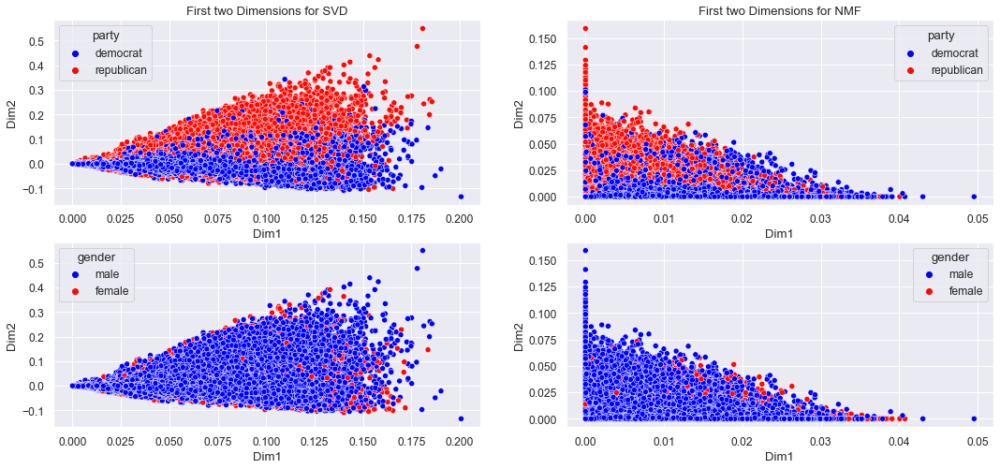

In [118]:
# plot scatter for 2D SVD and NMF with different hues 
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(nrows = 2,ncols=2, figsize=(18, 8))
ax1.title.set_text('First two Dimensions for SVD')
sns.scatterplot(data = svd_twodim_df, x = "Dim1", y = "Dim2", hue = "party", palette = "rocket",sns.color_palette(party_palette, 2), ax = ax1, )

ax2.title.set_text('First two Dimensions for NMF')
sns.scatterplot(data = nmf_twodim_df, x = "Dim1", y = "Dim2", hue = "party", palette = sns.color_palette(party_palette, 2), ax = ax2)

sns.scatterplot(data = svd_twodim_df, x = "Dim1", y = "Dim2", hue = "gender", palette = sns.color_palette(party_palette, 2), ax = ax3, )
sns.scatterplot(data = nmf_twodim_df, x = "Dim1", y = "Dim2", hue = "gender", palette = sns.color_palette(party_palette, 2), ax = ax4)

Shows nice separation between democrat and republican tweets. Separating tweets based on gender seems less feasible.

One can also take a look at outlier tweets:

In [348]:
df.loc[nmf_twodim_df[nmf_twodim_df["Dim1"] == nmf_twodim_df["Dim1"].max()].index.values.astype(int)[0],"text"]

'I’m pissed off today. https://t.co/QgXX9ikOvE'

In [350]:
df.loc[nmf_twodim_df[nmf_twodim_df["Dim1"] == nmf_twodim_df["Dim1"].min()].index.values.astype(int)[0],"text"]

'From a strong list of prospective candidates, President Biden has chosen an extraordinary nominee in D.C. Circuit Judge Ketanji Brown Jackson.'

In [352]:
df.loc[nmf_twodim_df[nmf_twodim_df["Dim2"] == nmf_twodim_df["Dim2"].max()].index.values.astype(int)[0],"text"]

'Biden Arrow. https://t.co/1uSIdSWCPI'

In [353]:
df.loc[nmf_twodim_df[nmf_twodim_df["Dim2"] == nmf_twodim_df["Dim2"].min()].index.values.astype(int)[0],"text"]

'Today, we lost a true public servant. A refugee herself, Secretary Albright was a glass ceiling breaker, a champion for democracy and human rights, and a true model of what it means to be an American diplomat. May her legacy serve as a guiding light to future generations.'

#### Three Dimensional SVD and NMF

In [121]:
#reduce the TDIDF Matrix to three dimensions for three-dimensional visualization
three_dim_svd = TruncatedSVD(n_components=3)
three_dim_U = three_dim_svd.fit_transform(X)
three_dim_nmf = NMF(n_components=3, init='nndsvd', random_state=0)
three_dim_V = three_dim_nmf.fit_transform(X)

In [122]:
# put result into df for later visualization
svd_threedim_df = pd.DataFrame({'Dim1': three_dim_U[:,0], 'Dim2': three_dim_U[:,1], 'Dim3': three_dim_U[:,2],"party" : df["party"],  "region" : df["region"], "gender" : df["gender"], "religion" : df["religion"], "openly_lgbtq" : df["openly_lgbtq"], "state" : df["state_name"]})
nmf_threedim_df = pd.DataFrame({'Dim1': three_dim_V[:,0], 'Dim2': three_dim_V[:,1], 'Dim3': three_dim_V[:,2],"party" : df["party"],  "region" : df["region"], "gender" : df["gender"], "religion" : df["religion"], "openly_lgbtq" : df["openly_lgbtq"], "state" : df["state_name"], "state_code" : df["state_code"]})

In [123]:
# plot three dimensional SVD graph with plotly
fig = px.scatter_3d(svd_threedim_df, x='Dim1', y='Dim2', z='Dim3',
              color='party', title = "Three-Dimensional SVD Graph")
fig.show()

As plotly results are usually not maintained in the notebooks without executing the code, the graph is also enclosed as a png file in the assignment folder (svd_3d.png).

In [124]:
# plot three dimensional NMF graph with plotly
fig = px.scatter_3d(nmf_threedim_df, x='Dim1', y='Dim2', z='Dim3',
              color='party', title = "3-Dimensional NMF Graph")
fig.show()

As plotly results are usually not maintained in the notebooks without executing the code, the graph is also enclosed as a png file in the assignment folder (nmf_3d.png).

Again, both methods enable a fairly clean separation of tweets between parties.

#### Visualizing Regional Variation

I further used the results of the dimensionality reduction to visualize regional variation similar to Hovy & Purschke (2018). Instead of mapping three dimensions to an RGB code, I decided to only use the first two principal components of NMF and map them to only red and blue while keeping the parameter for green at zero. Thereby, I hoped to resemble a map similar to the US election results, showing blue for Democratic states and red for Republican states.

In [125]:
# group dataframe to get mean value of the first three principal components per us state
state_nmf = nmf_twodim_df.groupby("state_code").mean()
state_nmf.reset_index(inplace = True)

In [126]:
# as seen in the two-dimensional visualization, dimension one mainly determines democratic tweets, whereas
# dimension two mainly determines republican tweets. Therefore, dimension one is chosen to determine the level of blue
# and dimension two is chosen to determine the level of red. 

dimensions_toscale = state_nmf[['Dim1', 'Dim2']]

# use MinMaxScalar across the two dimensions to normalize components
scaler = MinMaxScaler().fit(dimensions_toscale.values)
features = scaler.transform(dimensions_toscale.values)

# multiply normalized components by 255 to get corresponding RGB values for red and blue 
state_nmf[['Blue', 'Red']] = features*255
state_nmf['Blue'] = np.rint(state_nmf['Blue']).astype(int)
state_nmf['Red'] = np.rint(state_nmf['Red']).astype(int)
state_nmf["Green"] = 0

In [127]:
# transform RGB values into hex-code for later plotting 
def rgb_to_hex(rgb):
    return '#%02x%02x%02x' % rgb

state_nmf["rgb"] = list(zip(state_nmf.Red, state_nmf.Green, state_nmf.Blue))
state_nmf["hex"] = state_nmf.rgb.apply(rgb_to_hex)

In [128]:
# set parameters and create plot using plotly
state_nmf_dict = state_nmf[["state_code","hex"]]
hex_mapping = dict(state_nmf_dict.values)

fig = px.choropleth(locations=state_nmf["state_code"], locationmode="USA-states", scope="usa", color = state_nmf["state_code"], 
                    color_discrete_map=hex_mapping, title = "Colored Map of First Two NMF Components Interpreted as Red and Blue (Reflecting Linguistic Similarity)")

fig.show()

While not being perfect, the resulting map shows some similarity to the 2020 us election map with most of the Democratic strongholds (especially east and west cost) being blue and most of the Republican strongholds (southern states) being red.  

As plotly results are usually not maintained in the notebooks without executing the code, the graph is also enclosed as a png file in the assignment folder (regional_variation.png).

### 2.5 Classification

As the dimensionality reduction has shown that the tweets can be separated fairly well, I also want to explore if tweets can be reliably classified as either coming from a democrat or a republican. I, therefore, fit a logistic regression model on the TFIDF matrix. 

In [155]:
# perform train test split
y_party = df["democrat"]
X_train_party, X_test_party, y_train_party, y_test_party = train_test_split(X, y_party, test_size=0.30, random_state=101)

In [156]:
# fit logistic regression
lr_party = LogisticRegression()
lr_party.fit(X_train_party, y_train_party)
predictions_party = lr_party.predict(X_test_party)

In [157]:
# evaluate results
print(classification_report(y_test_party,predictions_party))

              precision    recall  f1-score   support

           0       0.86      0.83      0.84     11249
           1       0.86      0.89      0.87     13224

    accuracy                           0.86     24473
   macro avg       0.86      0.86      0.86     24473
weighted avg       0.86      0.86      0.86     24473



Results look better than expected (relatively high f1-score) and could probably even be improved by deploying more sophisticated algorithms (SVMs, neural nets) and better hyper-parameter optimization. 

While I was on it, I also tried if predicting the gender from a tweet is possible. However, the results are not convincing as the model classifies most tweets as male, which is probably due to the unbalanced sample. 

In [158]:
# perform train test split
y_gender = df["male"]
X_train_gender, X_test_gender, y_train_gender, y_test_gender = train_test_split(X, y_gender, test_size=0.30, random_state=101)

In [159]:
# fit logistic regression
lr_gender = LogisticRegression()
lr_gender.fit(X_train_gender, y_train_gender)
predictions_gender = lr_gender.predict(X_test_gender)

In [160]:
# evaluate results
print(classification_report(y_test_gender,predictions_gender))

              precision    recall  f1-score   support

           0       0.81      0.29      0.43      6157
           1       0.80      0.98      0.88     18316

    accuracy                           0.81     24473
   macro avg       0.81      0.63      0.66     24473
weighted avg       0.81      0.81      0.77     24473



In [161]:
# set plotting parameters party
cf_matrix_party = confusion_matrix(y_test_party,predictions_party)
group_names_party = ['True Rep.','False Rep.','False Dem.','True Dem.']
group_counts_party = ['{0:0.0f}'.format(value) for value in
                cf_matrix_party.flatten()]
group_percentages_party = ['{0:.2%}'.format(value) for value in
                     cf_matrix_party.flatten()/np.sum(cf_matrix_party)]
labels_party = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names_party,group_counts_party,group_percentages_party)]
labels_party = np.asarray(labels_party).reshape(2,2)

#set plotting parameters gender
cf_matrix_gender = confusion_matrix(y_test_gender,predictions_gender)
group_names_gender = ['True Female','False Female','False Male','True Male']
group_counts_gender = ['{0:0.0f}'.format(value) for value in
                cf_matrix_gender.flatten()]
group_percentages_gender = ['{0:.2%}'.format(value) for value in
                     cf_matrix_gender.flatten()/np.sum(cf_matrix_gender)]
labels_gender = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names_gender,group_counts_gender,group_percentages_gender)]
labels_gender = np.asarray(labels_gender).reshape(2,2)

<AxesSubplot:title={'center':'Confusion Matrix Heatmap for Gender Classification'}>

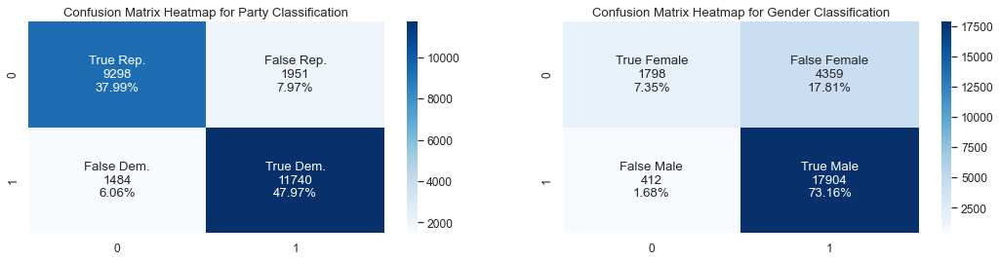

In [163]:
# plot heatmaps
fig, (ax1, ax2) = plt.subplots(nrows = 1,ncols=2, figsize=(18, 4))
ax1.title.set_text('Confusion Matrix Heatmap for Party Classification')
sns.heatmap(cf_matrix_party, annot=labels_party, fmt="", cmap='Blues', ax = ax1)
ax2.title.set_text('Confusion Matrix Heatmap for Gender Classification')
sns.heatmap(cf_matrix_gender, annot=labels_gender, fmt="", cmap='Blues', ax = ax2)

### 2.6 Language Models

To counter the army of bots on Twitter and to potentially launch a lazy political campaign, I also created a language model to generate typical republican or democratic tweets. Additionally, new tweets can be analyzed for their party affiliation by calculating log-likelihood.

In [164]:
documents_dem = df_dem.text.tolist()
corpus_dem = [document.split() for document in documents_dem]

documents_rep = df_rep.text.tolist()
corpus_rep = [document.split() for document in documents_rep]

# define smoothing and special tokens
smoothing = 0.001
START = '_***_'
STOP = '_STOP_'

# P(w|u,v): map from (u, v) to w to allow marginalizing
counts_dem = defaultdict(lambda: defaultdict(lambda: smoothing))
counts_rep = defaultdict(lambda: defaultdict(lambda: smoothing))

# collect dem counts for MLE
for sentence in corpus_dem:
    # include special tokens for start and the end of sentence
    tokens_dem = [START, START] + sentence + [STOP]
    # iterate over trigrams
    for u, v, w in nltk.ngrams(tokens_dem, 3):
        counts_dem[(u, v)][w] += 1
        
# collect rep counts for MLE
for sentence in corpus_rep:
    # include special tokens for start and the end of sentence
    tokens_rep = [START, START] + sentence + [STOP]
    # iterate over trigrams
    for u, v, w in nltk.ngrams(tokens_rep, 3):
        counts_rep[(u, v)][w] += 1  

def logP(u, v, w, party):
    """
    compute the log probability of a trigram
    (u,v,w) => P(w|u,v) = c(u,v,w) / SUM(c(u,v,*))
    """
    if party == "democrat":
        return np.log(counts_dem[(u, v)][w]) - np.log(sum(counts_dem[(u, v)].values()))
    
    elif party == "republican":
        return np.log(counts_rep[(u, v)][w]) - np.log(sum(counts_rep[(u, v)].values()))

def sentence_logP(S, party):
    """
    score a sentence in log likelihood with chain rule
    S: list(str)
    """
    if party == "democrat":
        tokens_dem = [START, START] + S + [STOP]
        return sum([logP(u, v, w, "democrat") for u, v, w in nltk.ngrams(tokens_dem, 3)])
    
    elif party == "republican":
        tokens_rep = [START, START] + S + [STOP]
        return sum([logP(u, v, w, "republican") for u, v, w in nltk.ngrams(tokens_rep, 3)])

def sample_next_word(u, v, party):
    """
    sample a word w based on the history (u, v)
    """
    
    if party == "democrat": 
        
        # separate word and their counts into separate variables
        keys, values = zip(*counts_dem[(u, v)].items())

        # normalize the counts into a probability distribution
        values = np.array(values)
        values /= values.sum() # create probability distro

        # this is the meat of the function
        sample = np.random.multinomial(1, values) # pick one position

        
    elif party == "republican": 
                # separate word and their counts into separate variables
        keys, values = zip(*counts_rep[(u, v)].items())

        # normalize the counts into a probability distribution
        values = np.array(values)
        values /= values.sum() # create probability distro

        # this is the meat of the function
        sample = np.random.multinomial(1, values) # pick one position
    
    return keys[np.argmax(sample)]

def generate(party):
    """
    generate a new sentence
    """
    # start with special tokens
    result = [START, START]
    # sample the first word
    next_word = sample_next_word(result[-2], result[-1], party)
    result.append(next_word)
    # repeat until you draw a stop token
    while next_word != STOP:
        next_word = sample_next_word(result[-2], result[-1], party)
        result.append(next_word)
    
    return ' '.join(result[2:-1])

Can now generate tweets for democrats and republicans

In [329]:
print(generate("democrat"))

Parents shouldn't have to bear the title: Supreme Court nominee.


In [323]:
print(generate("republican"))

Attorney General Garland to Investigate Dr. Fauci get away with this vaccine mandate on every American, regardless of their reckless taxing and spending spree would destroy 1.4 million jobs. Dems must stop Joe Biden’s vaccine mandates—our work to ensure taxpayer $$$ to Hamas &amp; Palestinian terrorist group Hamas. There is no reason to enter the country. https://t.co/L21u5xq3hX


Can also score sentence log likelihood for other tweets. For this test, I just picked a random tweet of president Biden and a random tweet of Kevin McCarthy (Republican House Minority Leader). 

In [331]:
tweet_biden = """I’m on my way to Europe to rally the international community in support of Ukraine and 
ensure Putin pays a severe economic cost for his war of choice."""

In [332]:
sentence_logP(tweet_biden.split(), party = "democrat")

-141.28314273170943

In [333]:
sentence_logP(tweet_biden.split(), party = "republican")

-166.51058527633765

In [286]:
tweet_mccarthy = """Gas prices hit an all-time high. Inflation is costing families thousands. Our southern border 
is out of control. Crime is surging in cities across America. Each of these crises started the day President Biden
was sworn into office."""

In [287]:
sentence_logP(tweet_mccarthy.split(), party = "democrat")

-161.61737103650472

In [288]:
sentence_logP(tweet_mccarthy.split(), party = "republican")

-148.88270291686598

As one would expect, for both tweet the log-likelihood is higher for the model of their associated political party.

### 2.7 Named Entity Analyis

I also conducted a quick named entity analysis over time to see if certain topics or events primarily trigger democratic or republican responses.

In [289]:
# creating dataframe for entity analysis over time
entity_df = pd.DataFrame()
entity_df["party"] = df["party"]
entity_df["date"] = pd.to_datetime(df["created_at"])
entity_df["day"] = entity_df.date.dt.strftime('%Y-%m-%d')
entity_df.drop("date", axis = 1, inplace = True)
entity_df["text"] = df['tweet_clean_aggressive']

In [290]:
# returing slected entities for each tweet
def return_entities(text): 
    l = []
    for ent in nlp(text).ents:
        if ent.label_ in {"GPE", "PERSON", "EVENT", "ORGANIZATION"}:
            l.append(ent.text)
    return ' '.join(l)

In [291]:
entity_df["entities"] = entity_df.text.apply(return_entities)

In [292]:
# adding entity count for each tweet 
warnings.filterwarnings('ignore')
for row in entity_df.index:
    for entity in entity_df.at[row, "entities"].split():
        entity_df.at[row,entity] = 1

In [293]:
# clean and format dataframe 
entity_df = entity_df.fillna(0)
entity_df["day"] = pd.to_datetime(entity_df["day"], format = "%Y-%m-%d").dt.strftime('%Y-%m-%d')
entity_df = entity_df[entity_df["day"] > entity_df["day"].min()]

In [294]:
# group and split data frame
entity_df_dem = entity_df[entity_df["party"] == "democrat"]
entity_df_group_dem = entity_df_dem.groupby("day").sum()
entity_df_group_dem = entity_df_group_dem.reset_index()

entity_df_rep = entity_df[entity_df["party"] == "republican"]
entity_df_group_rep = entity_df_rep.groupby("day").sum()
entity_df_group_rep = entity_df_group_rep.reset_index()

In [365]:
# create function for plotting
def plot_response(term): 
    ax = entity_df_group_dem.plot(x="day", y=[term], kind="line", figsize=(18, 4),linewidth=2, color = "blue", label = ["Democratic Response"])
    ax.set_title(f"Daily Tweets Including the Keyword {term.capitalize()} for US Senators", weight='bold')
    ax.set_ylabel(f"# Tweets mentioning {term.capitalize()}", )
    entity_df_group_rep.plot(x="day", y=[term], kind="line", figsize=(18, 4),linewidth=2.2, ax = ax, color = "red", label = ["Republican Response"])

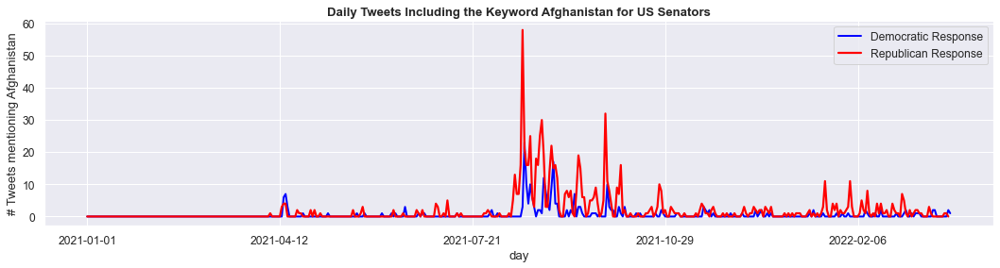

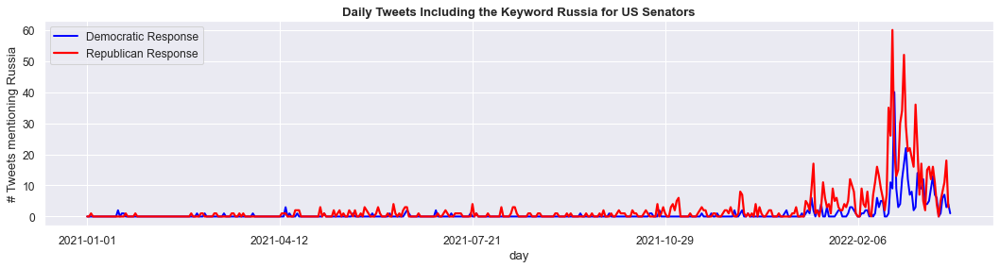

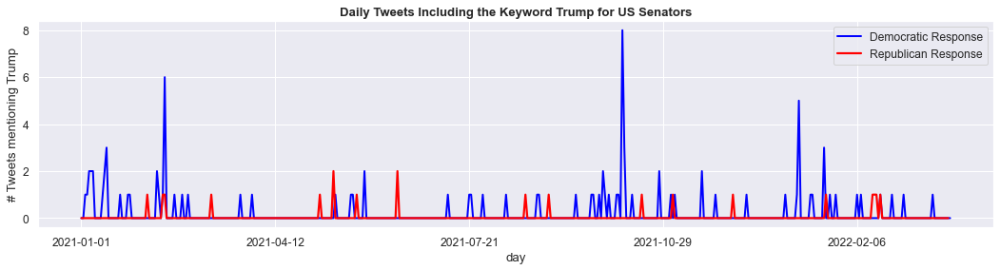

In [366]:
plot_response("afghanistan")
plot_response("russia")
plot_response("trump")

Interestingly, the two major foreign policy events concerning Afghanistan and Russia seemed to have triggered a stronger response among republican senators, even without accounting for the slightly smaller subset of tweets.